In [1]:
import pandas as pd
import re
import numpy as np
import matplotlib.pyplot as plt
from pprint import pprint
from bs4 import BeautifulSoup
from nltk.tokenize import WordPunctTokenizer
from wordcloud import WordCloud
import seaborn as sns
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.linear_model import LogisticRegression
from sklearn.pipeline import Pipeline
from time import time

In [2]:
csv = 'clean_tweet.csv'
my_df = pd.read_csv(csv, index_col=0)
my_df.dropna(inplace=True)
my_df.reset_index(drop=True,inplace=True)

C:\Users\LENOVO\anaconda3\lib\site-packages\numpy\lib\arraysetops.py:569: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  mask |= (ar1 == a)


In [3]:
my_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1596522 entries, 0 to 1596521
Data columns (total 2 columns):
 #   Column  Non-Null Count    Dtype 
---  ------  --------------    ----- 
 0   text    1596522 non-null  object
 1   target  1596522 non-null  int64 
dtypes: int64(1), object(1)
memory usage: 24.4+ MB


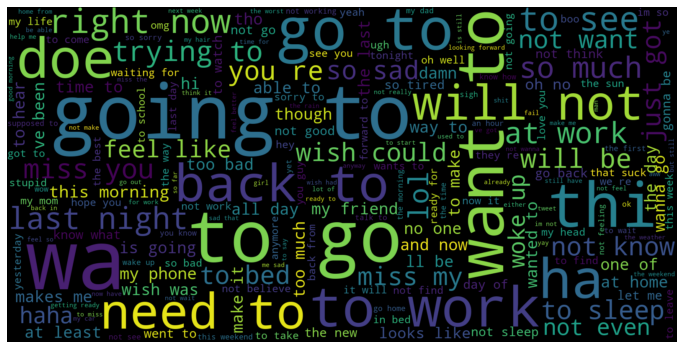

In [4]:
neg_tweets = my_df[my_df.target == 0]
neg_string = []
for t in neg_tweets.text:
    neg_string.append(t)
neg_string = pd.Series(neg_string).str.cat(sep=' ')
wordcloud = WordCloud(width=1600, height=800,max_font_size=200).generate(neg_string)
plt.figure(figsize=(12,10))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

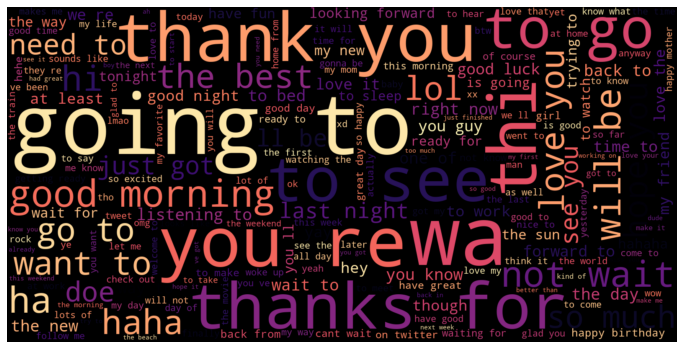

In [5]:
pos_tweets = my_df[my_df.target == 4]
pos_string = []
for t in pos_tweets.text:
    pos_string.append(t)
pos_string = pd.Series(pos_string).str.cat(sep=' ')
wordcloud = WordCloud(width=1600, height=800,max_font_size=200,colormap='magma').generate(pos_string)
plt.figure(figsize=(12,10))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

In [6]:
from sklearn.feature_extraction.text import CountVectorizer
cvec = CountVectorizer(stop_words = 'english')
cvec.fit(my_df.text)
len(cvec.get_feature_names())

271001

In [7]:
neg_doc_matrix = cvec.transform(my_df[my_df.target == 0].text)
pos_doc_matrix = cvec.transform(my_df[my_df.target == 4].text)
neg_tf = np.sum(neg_doc_matrix,axis=0)
pos_tf = np.sum(pos_doc_matrix,axis=0)
neg = np.squeeze(np.asarray(neg_tf))
pos = np.squeeze(np.asarray(pos_tf))
term_freq_df = pd.DataFrame([neg,pos],columns=cvec.get_feature_names()).transpose()

In [8]:
term_freq_df.columns = ['negative', 'positive']
term_freq_df['total'] = term_freq_df['negative'] + term_freq_df['positive']
term_freq_df.sort_values(by='total', ascending=False).iloc[:20]

,negative,positive,total
just,64006,62946,126952
good,29213,62122,91335
day,41456,48319,89775
like,41052,37527,78579
today,38118,30101,68219
work,45422,19534,64956
love,17061,47780,64841
going,33690,30939,64629
got,33413,28040,61453
lol,23123,36120,59243


Text(0.5, 1.0, 'Top 500 tokens in tweets')

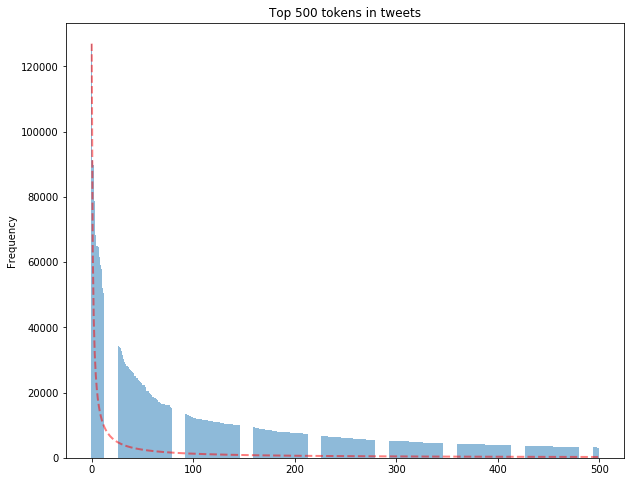

In [9]:
y_pos = np.arange(500)
plt.figure(figsize=(10,8))
s = 1
expected_zipf = [term_freq_df.sort_values(by='total', ascending=False)['total'][0]/(i+1)**s for i in y_pos]
plt.bar(y_pos, term_freq_df.sort_values(by='total', ascending=False)['total'][:500], align='center', alpha=0.5)
plt.plot(y_pos, expected_zipf, color='r', linestyle='--',linewidth=2,alpha=0.5)
plt.ylabel('Frequency')
plt.title('Top 500 tokens in tweets')

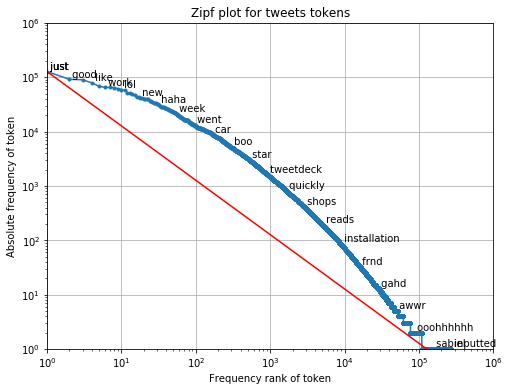

In [10]:
from pylab import *
counts = term_freq_df.total
tokens = term_freq_df.index
ranks = arange(1, len(counts)+1)
indices = argsort(-counts)
frequencies = counts[indices]
plt.figure(figsize=(8,6))
plt.ylim(1,10**6)
plt.xlim(1,10**6)
loglog(ranks, frequencies, marker=".")
plt.plot([1,frequencies[0]],[frequencies[0],1],color='r')
title("Zipf plot for tweets tokens")
xlabel("Frequency rank of token")
ylabel("Absolute frequency of token")
grid(True)
for n in list(logspace(-0.5, log10(len(counts)-2), 25).astype(int)):
    dummy = text(ranks[n], frequencies[n], " " + tokens[indices[n]], 
                 verticalalignment="bottom",
                 horizontalalignment="left")

Text(0.5, 1.0, 'Top 50 tokens in negative tweets')

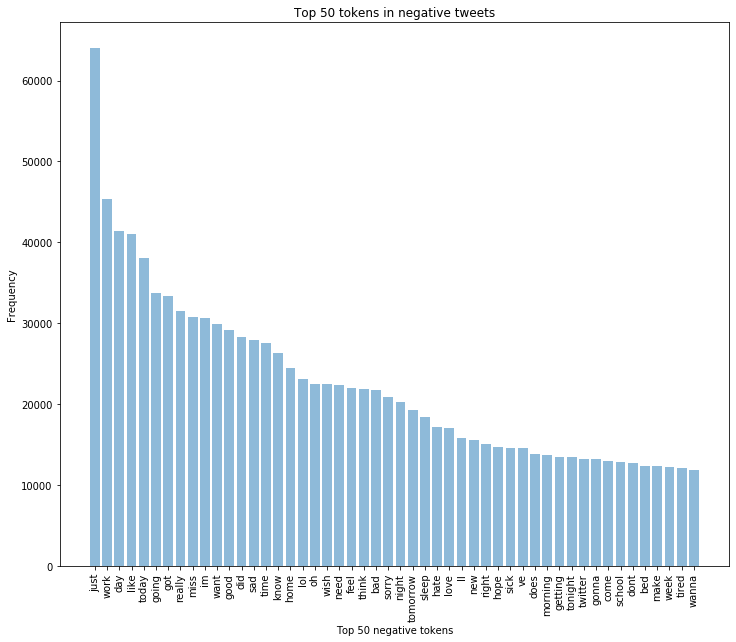

In [11]:
y_pos = np.arange(50)
plt.figure(figsize=(12,10))
plt.bar(y_pos, term_freq_df.sort_values(by='negative', ascending=False)['negative'][:50], align='center', alpha=0.5)
plt.xticks(y_pos, term_freq_df.sort_values(by='negative', ascending=False)['negative'][:50].index,rotation='vertical')
plt.ylabel('Frequency')
plt.xlabel('Top 50 negative tokens')
plt.title('Top 50 tokens in negative tweets')

Text(0.5, 1.0, 'Top 50 tokens in positive tweets')

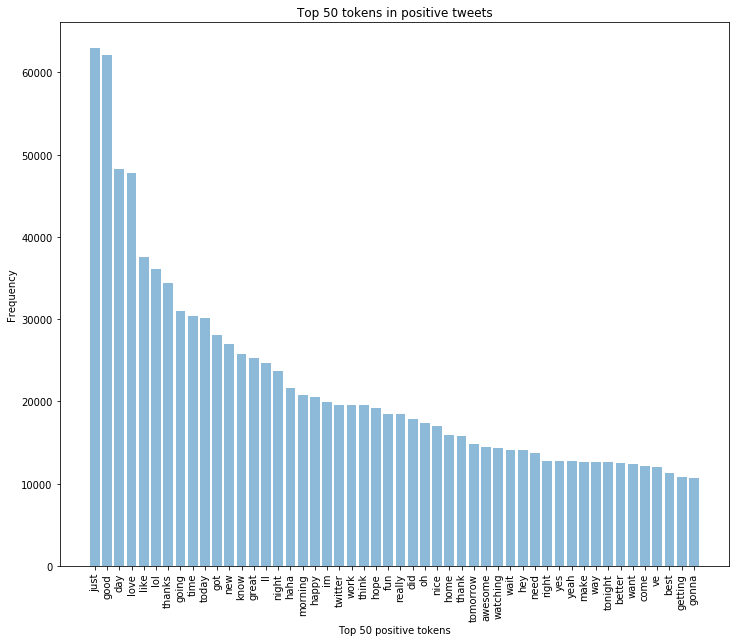

In [12]:
y_pos = np.arange(50)
plt.figure(figsize=(12,10))
plt.bar(y_pos,term_freq_df.sort_values(by='positive', ascending=False)['positive'][:50], align='center', alpha=0.5)
plt.xticks(y_pos,term_freq_df.sort_values(by='positive', ascending=False)['positive'][:50].index,rotation='vertical')
plt.ylabel('Frequency')
plt.xlabel('Top 50 positive tokens')
plt.title('Top 50 tokens in positive tweets')

Text(0.5, 1.0, 'Negative Frequency vs Positive Frequency')

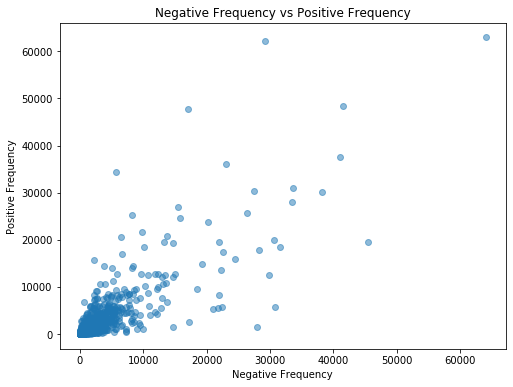

In [13]:
plt.figure(figsize=(8,6))
ax = sns.regplot(x="negative", y="positive",fit_reg=False, scatter_kws={'alpha':0.5},data=term_freq_df)
plt.ylabel('Positive Frequency')
plt.xlabel('Negative Frequency')
plt.title('Negative Frequency vs Positive Frequency')

In [14]:
term_freq_df['pos_rate'] = term_freq_df['positive'] * 1./term_freq_df['total']
term_freq_df.sort_values(by='pos_rate', ascending=False).iloc[:10]

,negative,positive,total,pos_rate
lincons,0,1,1,1.0
shattard,0,1,1,1.0
shatori,0,3,3,1.0
hahu,0,1,1,1.0
haht,0,1,1,1.0
hahs,0,4,4,1.0
shatranjanpoli,0,1,1,1.0
hahm,0,1,1,1.0
hahje,0,1,1,1.0
hahhhh,0,2,2,1.0


In [15]:
term_freq_df['pos_freq_pct'] = term_freq_df['positive'] * 1./term_freq_df['positive'].sum()
term_freq_df.sort_values(by='pos_freq_pct', ascending=False).iloc[:10]

,negative,positive,total,pos_rate,pos_freq_pct
just,64006,62946,126952,0.495825,0.012773
good,29213,62122,91335,0.680155,0.012606
day,41456,48319,89775,0.538223,0.009805
love,17061,47780,64841,0.736879,0.009696
like,41052,37527,78579,0.477570,0.007615
lol,23123,36120,59243,0.609692,0.007330
thanks,5768,34378,40146,0.856324,0.006976
going,33690,30939,64629,0.478717,0.006278
time,27532,30438,57970,0.525065,0.006177
today,38118,30101,68219,0.441241,0.006108


In [16]:
from scipy.stats import hmean
term_freq_df['pos_hmean'] = term_freq_df.apply(lambda x: (hmean([x['pos_rate'], x['pos_freq_pct']])                                                               if x['pos_rate'] > 0 and x['pos_freq_pct'] > 0 else 0), axis=1)
term_freq_df.sort_values(by='pos_hmean', ascending=False).iloc[:10]

,negative,positive,total,pos_rate,pos_freq_pct,pos_hmean
just,64006,62946,126952,0.495825,0.012773,0.024905
good,29213,62122,91335,0.680155,0.012606,0.024754
day,41456,48319,89775,0.538223,0.009805,0.019260
love,17061,47780,64841,0.736879,0.009696,0.019140
like,41052,37527,78579,0.477570,0.007615,0.014991
lol,23123,36120,59243,0.609692,0.007330,0.014485
thanks,5768,34378,40146,0.856324,0.006976,0.013840
going,33690,30939,64629,0.478717,0.006278,0.012394
time,27532,30438,57970,0.525065,0.006177,0.012210
today,38118,30101,68219,0.441241,0.006108,0.012050


In [17]:
from scipy.stats import norm
def normcdf(x):
    return norm.cdf(x, x.mean(), x.std())
term_freq_df['pos_rate_normcdf'] = normcdf(term_freq_df['pos_rate'])
term_freq_df['pos_freq_pct_normcdf'] = normcdf(term_freq_df['pos_freq_pct'])
term_freq_df['pos_normcdf_hmean'] = hmean([term_freq_df['pos_rate_normcdf'], term_freq_df['pos_freq_pct_normcdf']])
term_freq_df.sort_values(by='pos_normcdf_hmean',ascending=False).iloc[:10]

,negative,positive,total,pos_rate,pos_freq_pct,pos_hmean,pos_rate_normcdf,pos_freq_pct_normcdf,pos_normcdf_hmean
followfriday,169,2731,2900,0.941724,0.000554,0.001108,0.828339,1.000000,0.906111
congratulations,101,1410,1511,0.933157,0.000286,0.000572,0.823206,0.999863,0.902976
welcome,620,6702,7322,0.915324,0.001360,0.002716,0.812215,1.000000,0.896378
vip,165,1634,1799,0.908282,0.000332,0.000663,0.807761,0.999988,0.893654
blessed,94,834,928,0.898707,0.000169,0.000338,0.801601,0.983549,0.883303
congrats,457,3312,3769,0.878748,0.000672,0.001343,0.788386,1.000000,0.881673
pleasure,112,880,992,0.887097,0.000179,0.000357,0.793976,0.987888,0.880381
smile,395,2749,3144,0.874364,0.000558,0.001115,0.785416,1.000000,0.879813
thank,2282,15737,18019,0.873356,0.003193,0.006364,0.784729,1.000000,0.879382
cheers,170,1133,1303,0.869532,0.000230,0.000460,0.782114,0.998222,0.877052


In [18]:
term_freq_df['neg_rate'] = term_freq_df['negative'] * 1./term_freq_df['total']
term_freq_df['neg_freq_pct'] = term_freq_df['negative'] * 1./term_freq_df['negative'].sum()
term_freq_df['neg_hmean'] = term_freq_df.apply(lambda x: (hmean([x['neg_rate'], x['neg_freq_pct']])                                                                if x['neg_rate'] > 0 and x['neg_freq_pct'] > 0                                                                else 0), axis=1)
                                                       
term_freq_df['neg_rate_normcdf'] = normcdf(term_freq_df['neg_rate'])
term_freq_df['neg_freq_pct_normcdf'] = normcdf(term_freq_df['neg_freq_pct'])
term_freq_df['neg_normcdf_hmean'] = hmean([term_freq_df['neg_rate_normcdf'], term_freq_df['neg_freq_pct_normcdf']])
term_freq_df.sort_values(by='neg_normcdf_hmean', ascending=False).iloc[:10]

,negative,positive,total,pos_rate,pos_freq_pct,pos_hmean,pos_rate_normcdf,pos_freq_pct_normcdf,pos_normcdf_hmean,neg_rate,neg_freq_pct,neg_hmean,neg_rate_normcdf,neg_freq_pct_normcdf,neg_normcdf_hmean
bummed,1745,94,1839,0.051115,0.000019,0.000038,0.129606,0.578576,0.211773,0.948885,0.000343,0.000686,0.870394,0.999997,0.930705
sad,27911,1510,29421,0.051324,0.000306,0.000609,0.129709,0.999952,0.229631,0.948676,0.005490,0.010917,0.870291,1.000000,0.930648
gutted,1339,84,1423,0.059030,0.000017,0.000034,0.133541,0.568322,0.216266,0.940970,0.000263,0.000527,0.866459,0.999715,0.928329
hurts,7204,456,7660,0.059530,0.000093,0.000185,0.133793,0.873864,0.232056,0.940470,0.001417,0.002830,0.866207,1.000000,0.928308
depressed,1291,86,1377,0.062455,0.000017,0.000035,0.135269,0.570376,0.218677,0.937545,0.000254,0.000508,0.864731,0.999551,0.927266
throat,2816,214,3030,0.070627,0.000043,0.000087,0.139454,0.695689,0.232336,0.929373,0.000554,0.001107,0.860546,1.000000,0.925047
headache,5317,421,5738,0.073371,0.000085,0.000171,0.140879,0.853904,0.241856,0.926629,0.001046,0.002089,0.859121,1.000000,0.924223
died,3475,281,3756,0.074814,0.000057,0.000114,0.141632,0.754034,0.238471,0.925186,0.000684,0.001366,0.858368,1.000000,0.923787
ache,1280,103,1383,0.074476,0.000021,0.000042,0.141455,0.587760,0.228031,0.925524,0.000252,0.000503,0.858545,0.999502,0.923677
upset,2517,216,2733,0.079034,0.000044,0.000088,0.143850,0.697516,0.238512,0.920966,0.000495,0.000990,0.856150,1.000000,0.922501


Text(0.5, 1.0, 'neg_normcdf_hmean vs pos_normcdf_hmean')

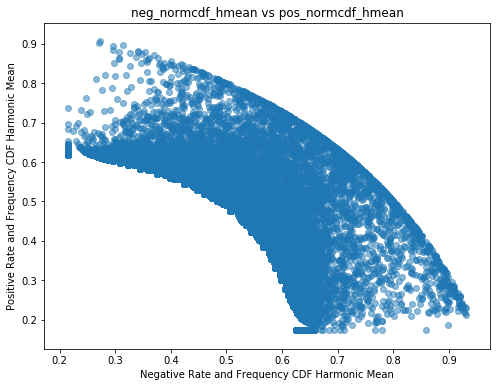

In [19]:
plt.figure(figsize=(8,6))
ax = sns.regplot(x="neg_normcdf_hmean", y="pos_normcdf_hmean",fit_reg=False, scatter_kws={'alpha':0.5},data=term_freq_df)
plt.ylabel('Positive Rate and Frequency CDF Harmonic Mean')
plt.xlabel('Negative Rate and Frequency CDF Harmonic Mean')
plt.title('neg_normcdf_hmean vs pos_normcdf_hmean')

In [20]:
from bokeh.plotting import figure
from bokeh.io import output_notebook, show
from bokeh.models import LinearColorMapper
from bokeh.models import HoverTool
output_notebook()
color_mapper = LinearColorMapper(palette='Inferno256', low=min(term_freq_df.pos_normcdf_hmean), high=max(term_freq_df.pos_normcdf_hmean))
p = figure(x_axis_label='neg_normcdf_hmean', y_axis_label='pos_normcdf_hmean')
p.circle('neg_normcdf_hmean','pos_normcdf_hmean',size=5,alpha=0.3,source=term_freq_df,color={'field': 'pos_normcdf_hmean', 'transform': color_mapper})
hover = HoverTool(tooltips=[('token','@index')])
p.add_tools(hover)
show(p)

Loading BokehJS ...

# Splitting into Training and Testing data In the next module